In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

cuda


torch.Size([8, 3, 64, 64])


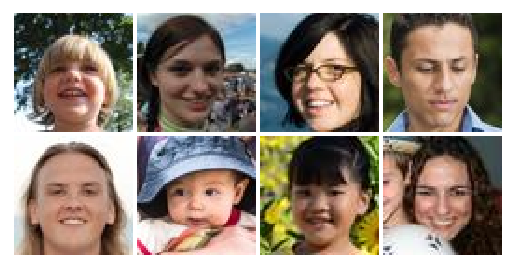

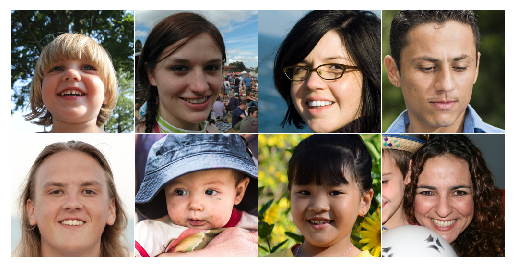

In [2]:
from PIL import Image

class RawDataset(torch.utils.data.Dataset):
    def __init__(self, n):
        import os
        self.filenames = sorted([s.split('.')[0] for s in os.listdir('00000/256')])
        self.n = len(self.filenames)

    def __len__(self):
        # return self.n
        return 960

    def __getitem__(self, i):
        f = self.filenames[i]
        f0 = f"00000/64/{f}.jpg"
        f1 = f"00000/256/{f}.png"
        v0 = np.array(Image.open(f0).convert("RGB"), dtype=np.float32) / 255.0
        v1 = np.array(Image.open(f1).convert("RGB"), dtype=np.float32) / 255.0
        return (
            np.transpose(v0, (2, 0, 1)),
            np.transpose(v1, (2, 0, 1))
        )


def plot_imgs(x):
    plt.figure()
    x = torch.clip(x, 0.0, 1.0)
    plt.imshow(np.transpose(vutils.make_grid(x[:8].cpu(),
        nrow=4, padding=2, pad_value=1, normalize=True), (1, 2, 0)),
                interpolation='nearest')
    plt.axis("off")
    plt.show()

for x, y in torch.utils.data.DataLoader(
    RawDataset(128),
    batch_size=8,
    shuffle=True
):
    break

print(x.shape)
plot_imgs(x)
plot_imgs(y)

In [3]:
def conv3(nin, nout):
    return nn.Conv2d(nin, nout, 3, padding=1)

def relu(x):
    return F.relu(x, inplace=False)


class ResidualBlock(nn.Module):
    def __init__(self, n):
        super(ResidualBlock, self).__init__()
        self.conv1 = conv3(n, n)
        self.conv2 = conv3(n, n)
    
    def forward(self, x):
        return self.conv2(relu(self.conv1(x))) + x


class Modelx4(torch.nn.Module):
    def __init__(self, n_in, n_out, n_hidden, n_residual):
        super(Modelx4, self).__init__()

        self.conv_i = conv3(n_in, n_hidden)
        self.residual = nn.Sequential(
            *[ResidualBlock(n_hidden) for _ in range(n_residual)]
        )
        self.conv_m = conv3(n_hidden, n_hidden)
        self.upscale = nn.Sequential(
            conv3(n_hidden, 4*n_hidden),
            nn.ReLU(),
            nn.PixelShuffle(2),
            conv3(n_hidden, 4*n_hidden),
            nn.ReLU(),
            nn.PixelShuffle(2)
        )
        # self.conv_o = nn.Conv2d(n_hidden, n_out, 7, padding=3)
        self.conv_o = nn.Conv2d(n_hidden, n_out, 3, padding=1)
    
    def forward(self, x):
        x_i = relu(self.conv_i(x))
        x_r = self.residual(x_i)
        x_m = self.conv_m(x_r) + x_i
        x_u = self.upscale(x_m)
        x_o = torch.sigmoid(self.conv_o(x_u))
        return x_o


model = Modelx4(3, 3, 32, 10).to(device)
print(model)
x = torch.randn((8, 3, 64, 64), device=device)
with torch.no_grad():
    y = model(x)
print(y.shape)

Modelx4(
  (conv_i): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (residual): Sequential(
    (0): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (1): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (2): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (3): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (4): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv2): 

In [4]:
def conv3s2(nin, nout):
    return nn.Conv2d(nin, nout, 3, stride=2, padding=1)

class Discriminator(torch.nn.Module):
    def __init__(self, n_in, n_hidden):
        super(Discriminator, self).__init__()
        self.main = torch.nn.Sequential(
            conv3(n_in, n_hidden),
            nn.LeakyReLU(),
            conv3s2(n_hidden, n_hidden),  # 1 -> 1/2
            nn.BatchNorm2d(n_hidden),
            nn.LeakyReLU(),
            conv3(n_hidden, 2*n_hidden),
            nn.BatchNorm2d(2*n_hidden),
            nn.LeakyReLU(),
            conv3s2(2*n_hidden, 2*n_hidden),  # 1/2 -> 1/4
            nn.BatchNorm2d(2*n_hidden),
            nn.LeakyReLU(),
            conv3(2*n_hidden, 4*n_hidden),
            nn.BatchNorm2d(4*n_hidden),
            nn.LeakyReLU(),
            conv3s2(4*n_hidden, 4*n_hidden),  # 1/4 -> 1/8
            nn.BatchNorm2d(4*n_hidden),
            nn.LeakyReLU(),
            conv3(4*n_hidden, 8*n_hidden),
            nn.BatchNorm2d(8*n_hidden),
            nn.LeakyReLU(),
            conv3s2(8*n_hidden, 8*n_hidden),  # 1/8 -> 1/16
            nn.BatchNorm2d(8*n_hidden),
            nn.LeakyReLU(),
            nn.AdaptiveMaxPool2d((4, 4)),
            nn.Flatten(),
            nn.Linear(128*n_hidden, 32*n_hidden),
            nn.LeakyReLU(),
            nn.Linear(32*n_hidden, 1),
        )

    def forward(self, x):
        return self.main(x)


discriminator = Discriminator(3, 8).to(device)
print(discriminator)
x = torch.randn((8, 3, 256, 256), device=device)
with torch.no_grad():
    y = discriminator(x)
print(y.shape)
print(y)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.01)
    (2): Conv2d(8, 8, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (3): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.01)
    (5): Conv2d(8, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.01)
    (8): Conv2d(16, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (9): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.01)
    (11): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (12): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (13): LeakyReLU(negative_slope=0.01)
    (14): Conv2d(32, 32, kernel_si

In [8]:
class CombinedLoss(torch.nn.Module):
    def __init__(self, lambda_a, lambda_p, lambda_f, lambda_t):
        super(CombinedLoss, self).__init__()
        self.lambda_a = lambda_a  # adversarial
        self.lambda_p = lambda_p  # pixel loss
        self.lambda_f = lambda_f  # feature loss (perceptual)
        self.lambda_t = lambda_t  # texture matching loss

        self.bce = torch.nn.BCEWithLogitsLoss()

        # vgg model for perceptual loss
        import torchvision.models
        vgg16 = torchvision.models.vgg16(weights='VGG16_Weights.DEFAULT')
        self.feature_extractor = vgg16.features[:4].to(device)
        print(self.feature_extractor)
        for param in self.feature_extractor.parameters():
            param.requires_grad = False
        self.feature_extractor_2 = vgg16.features[4:9].to(device)
        print(self.feature_extractor_2)
        for param in self.feature_extractor_2.parameters():
            param.requires_grad = False
        self.vgg_mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(device)
        self.vgg_std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(device)
    
    def feature_extractor_1(self, x):
        x = (x - self.vgg_mean) / self.vgg_std
        return self.feature_extractor(x)

    def forward(self, generated, target, discriminator_output, is_discriminator=False):
        # Adversarial Loss
        if is_discriminator:
            return self.bce(discriminator_output, target)
        loss_a = -torch.mean(discriminator_output)

        # Pixel Loss (Euclidean Distance, L1+L2 Loss)
        loss_p2 = torch.mean((generated-target)**2) / 0.05
        loss_p1 = torch.mean(torch.abs(generated-target))
        loss_p = 0.5*(loss_p1+loss_p2)

        # Feature Loss (Euclidean Distance, L1+L2 Loss)
        gen_features = self.feature_extractor_1(generated)
        target_features = self.feature_extractor_1(target)
        loss_f2 = torch.mean((gen_features-target_features)**2) / 0.25
        loss_f1 = torch.mean(torch.abs(gen_features-target_features))
        gen_features_2 = self.feature_extractor_2(gen_features)
        target_features_2 = self.feature_extractor_2(target_features)
        loss_f2_2 = torch.mean((gen_features_2-target_features_2)**2) / 0.25
        loss_f1_2 = torch.mean(torch.abs(gen_features_2-target_features_2))
        loss_f = 0.25*(loss_f1+loss_f2+loss_f1_2+loss_f2_2)

        # Texture Loss - to do

        # Composite Loss
        total_loss = self.lambda_a * loss_a + \
                        self.lambda_p * loss_p + \
                        self.lambda_f * loss_f

        return total_loss


lossfun = CombinedLoss(0.1, 1.0, 1.0, 0.0)
print(lossfun)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
)
Sequential(
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
)
CombinedLoss(
  (bce): BCEWithLogitsLoss()
  (feature_extractor): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
  )
  (feature_extractor_2): Sequential(
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6):

In [9]:
optimizer = torch.optim.Adam(
    model.parameters(),
    lr=0.001
)
from torch.optim import lr_scheduler
scheduler = lr_scheduler.ReduceLROnPlateau(
    optimizer, mode='min', factor=0.1, patience=10, min_lr=0.0, verbose=True)

optimizer_d = torch.optim.Adam(
    discriminator.parameters(),
    lr = 0.0005
)

discriminator_params = torch.cat([x.view(-1) for x in discriminator.parameters()])

4 g 5.160799980163574 d 3.0843026638031006
8 g 4.147189140319824 d 9.069375991821289
12 g 4.156500339508057 d 2.2941582202911377
16 g 4.4917097091674805 d 1.4307067394256592
20 g 4.04079532623291 d 1.3339033126831055
24 g 4.483613967895508 d 1.2612974643707275
28 g 3.735456943511963 d 1.2432594299316406
32 g 3.676997423171997 d 1.1989097595214844
36 g 3.46759295463562 d 1.2277107238769531
40 g 3.4879865646362305 d 1.2343285083770752
44 g 4.387780666351318 d 1.159963607788086
48 g 4.046874523162842 d 1.0829174518585205
52 g 4.1725006103515625 d 1.020908236503601
56 g 4.1133646965026855 d 1.0442664623260498
60 g 3.9085354804992676 d 0.9943215250968933


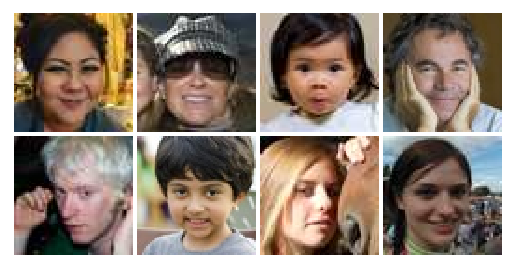

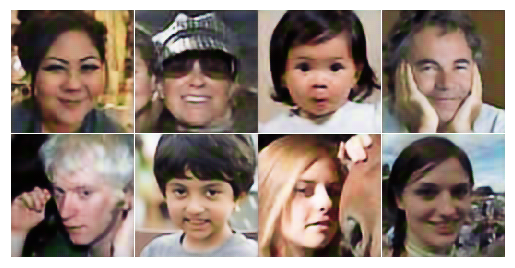

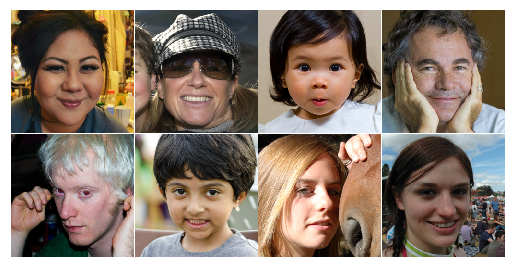

4 g 4.088149547576904 d 1.0973005294799805
8 g 3.7750911712646484 d 0.9876129627227783
12 g 4.016231060028076 d 1.0999188423156738
16 g 4.00816535949707 d 1.2095789909362793
20 g 4.133867263793945 d 1.308046579360962
24 g 3.9102182388305664 d 1.3648827075958252
28 g 3.298741102218628 d 1.0905953645706177
32 g 3.467350482940674 d 0.931459903717041
36 g 4.095111846923828 d 0.7138702869415283
40 g 3.7635891437530518 d 0.806354284286499
44 g 4.0872063636779785 d 0.764335572719574
48 g 3.9443862438201904 d 1.5237879753112793
52 g 3.4717748165130615 d 1.1641619205474854
56 g 3.857788562774658 d 1.4988315105438232
60 g 3.84673810005188 d 1.3551040887832642


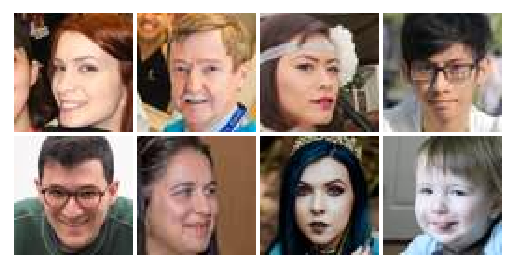

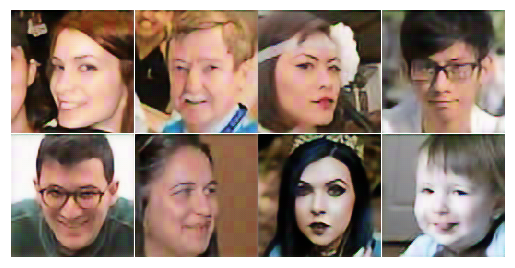

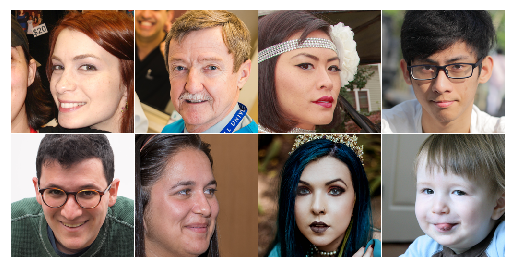

4 g 4.33577299118042 d 1.1465129852294922
8 g 3.5584096908569336 d 1.0664674043655396
12 g 3.666165351867676 d 1.1999824047088623
16 g 3.8395678997039795 d 1.4827579259872437
20 g 3.6202378273010254 d 2.1195363998413086
24 g 3.4684784412384033 d 1.2163114547729492
28 g 3.9567158222198486 d 1.1084282398223877
32 g 3.9129691123962402 d 0.8199325203895569
36 g 3.4551901817321777 d 0.814973771572113
40 g 3.7504374980926514 d 0.8247957825660706
44 g 3.780644416809082 d 1.0749071836471558
48 g 3.9217631816864014 d 1.0776877403259277
52 g 3.6358954906463623 d 1.0464682579040527
56 g 3.779348611831665 d 0.930716335773468
60 g 3.7298946380615234 d 0.8883838653564453


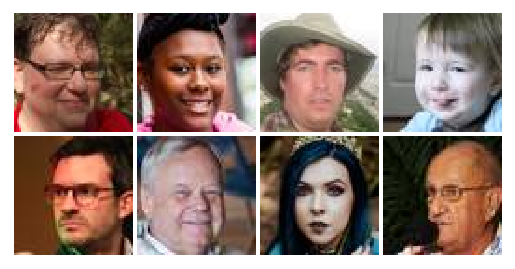

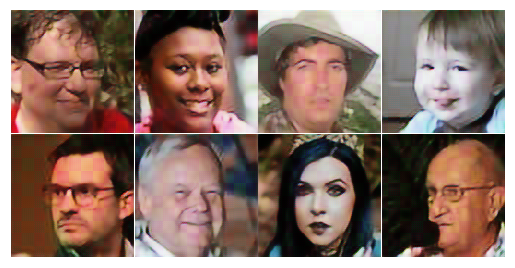

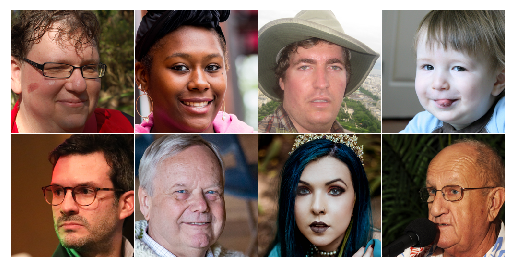

4 g 4.327171802520752 d 0.6721651554107666
8 g 3.8902969360351562 d 1.0715274810791016
12 g 3.8918817043304443 d 1.5675349235534668
16 g 4.497827529907227 d 1.3610199689865112
20 g 3.8360068798065186 d 1.677901029586792
24 g 3.609119415283203 d 1.199029564857483
28 g 4.499021530151367 d 1.0705444812774658
32 g 3.5160934925079346 d 0.8459212779998779
36 g 3.7412314414978027 d 1.124792456626892
40 g 4.13875150680542 d 1.3593556880950928
44 g 3.8855671882629395 d 0.8366349935531616
48 g 3.6503310203552246 d 0.9961861371994019
52 g 3.571059226989746 d 1.0499790906906128
56 g 3.480994701385498 d 0.7699667811393738
60 g 3.529252290725708 d 1.065397024154663


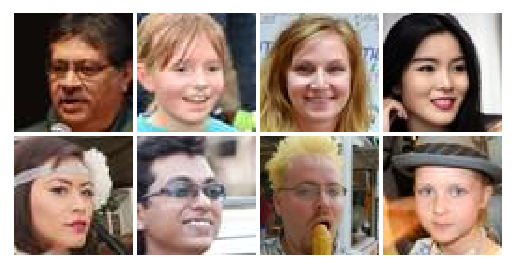

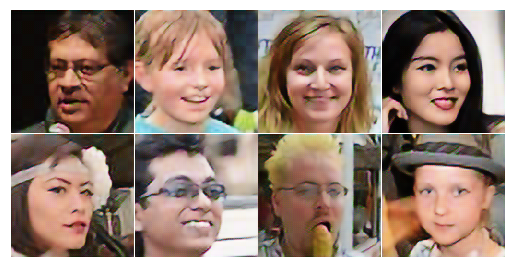

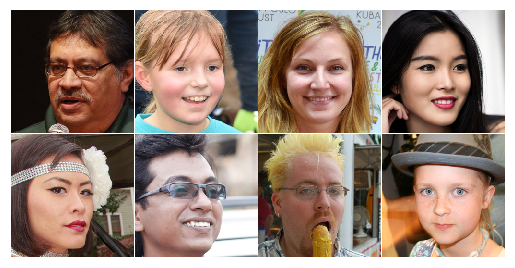

4 g 3.7568671703338623 d 0.9967488050460815
8 g 3.4084761142730713 d 1.8885400295257568
12 g 4.299820423126221 d 0.7067477703094482
16 g 3.5979228019714355 d 1.41205894947052
20 g 3.547271490097046 d 0.8733537793159485
24 g 3.510624647140503 d 0.7530873417854309
28 g 3.305156707763672 d 1.146672248840332
32 g 3.951232433319092 d 1.5632659196853638
36 g 3.9500372409820557 d 1.6099402904510498
40 g 3.629840612411499 d 1.4821640253067017
44 g 4.5096821784973145 d 1.0569710731506348
48 g 3.5863821506500244 d 0.7549523115158081
52 g 3.61238956451416 d 0.6889763474464417
56 g 3.4885413646698 d 0.7430591583251953
60 g 3.714703321456909 d 1.0524234771728516


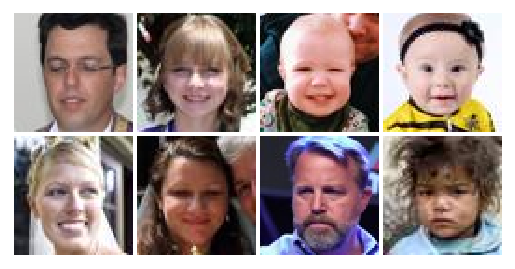

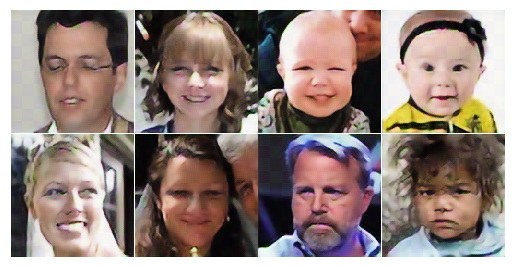

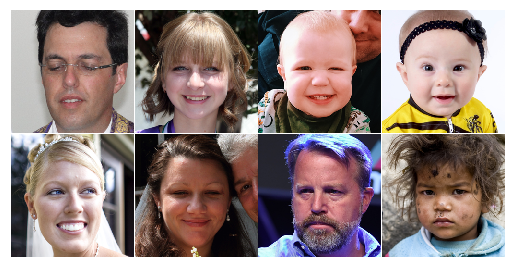

4 g 3.383582830429077 d 1.3770859241485596
8 g 4.19727087020874 d 1.6340746879577637
12 g 3.9198567867279053 d 0.6137821674346924
16 g 4.181817054748535 d 1.0400946140289307
20 g 4.1166510581970215 d 0.9236826300621033
24 g 3.603464126586914 d 0.8667004108428955
28 g 3.7825019359588623 d 0.9953906536102295
32 g 3.8192901611328125 d 1.3353006839752197
36 g 4.125459671020508 d 1.1627476215362549
40 g 4.177891254425049 d 1.7506356239318848
44 g 3.6807703971862793 d 1.2009117603302002
48 g 3.945984125137329 d 0.9994171261787415
52 g 3.261308193206787 d 0.9736424684524536
56 g 4.438958168029785 d 0.7756774425506592
60 g 3.2775495052337646 d 0.637648344039917


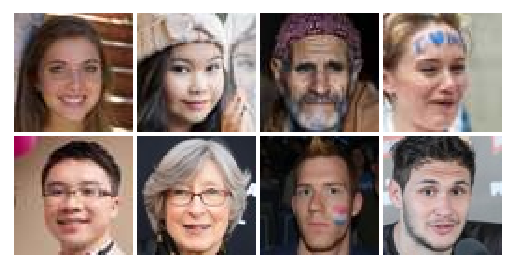

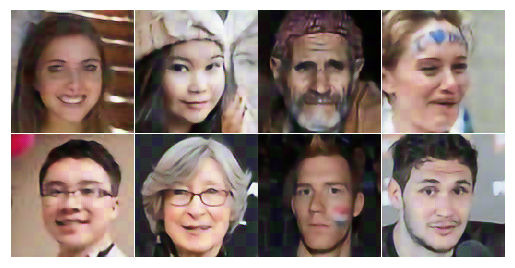

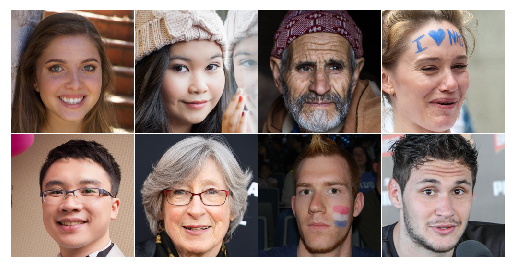

4 g 3.7867348194122314 d 0.9325972199440002
8 g 3.7508811950683594 d 0.7589865922927856
12 g 3.8227615356445312 d 1.7514742612838745
16 g 3.5171706676483154 d 1.5846340656280518
20 g 3.830272674560547 d 0.8285872936248779
24 g 3.6347811222076416 d 1.2191925048828125
28 g 4.084040641784668 d 0.6562065482139587
32 g 3.899343967437744 d 1.3406789302825928
36 g 3.541851282119751 d 1.428221344947815
40 g 3.383352041244507 d 0.9902740716934204
44 g 3.8897345066070557 d 1.1895676851272583
48 g 3.815048933029175 d 0.5209940671920776
52 g 3.6034345626831055 d 2.1977479457855225
56 g 3.530317544937134 d 0.9890764355659485
60 g 3.552823066711426 d 1.2569786310195923


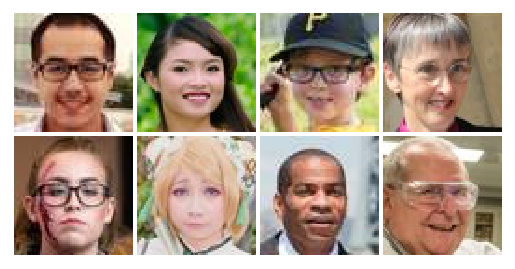

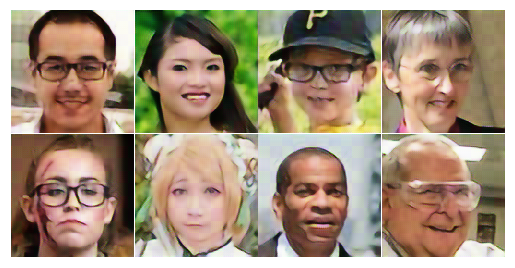

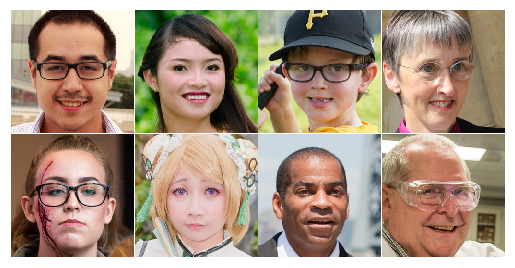

4 g 3.738215446472168 d 1.0900565385818481
8 g 3.9303319454193115 d 0.5148520469665527
12 g 4.272013187408447 d 1.6480937004089355
16 g 3.6203043460845947 d 1.914177656173706
20 g 3.5927727222442627 d 1.7360460758209229
24 g 3.6926708221435547 d 2.030564785003662
28 g 3.7431905269622803 d 0.6613754630088806
32 g 3.4350011348724365 d 1.2913613319396973
36 g 3.4500913619995117 d 0.7524974942207336
40 g 4.074315071105957 d 0.4724406599998474
44 g 3.700650215148926 d 0.7087257504463196
48 g 3.7392611503601074 d 0.6810075044631958
52 g 3.349515199661255 d 0.8922891616821289
56 g 3.7638981342315674 d 2.2317111492156982
60 g 3.070189952850342 d 1.5622079372406006


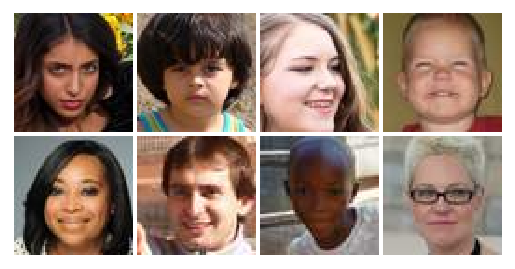

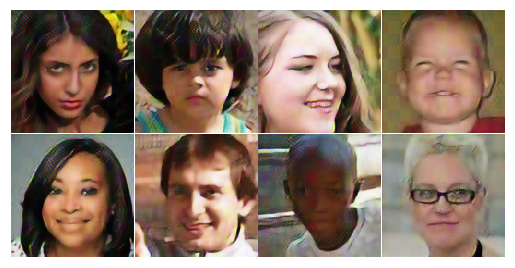

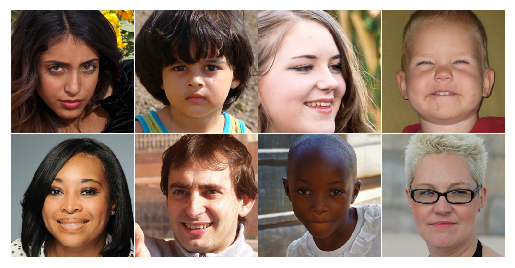

4 g 4.02966833114624 d 0.9799268841743469
8 g 3.5909109115600586 d 0.8407689332962036
12 g 3.1205289363861084 d 0.7825674414634705
16 g 3.7360129356384277 d 1.0798766613006592
20 g 3.4746367931365967 d 0.6760466694831848
24 g 3.57761812210083 d 1.225190281867981
28 g 3.518540382385254 d 0.7254925966262817
32 g 3.9395933151245117 d 1.4975323677062988
36 g 3.6768712997436523 d 1.1145226955413818
40 g 3.645817995071411 d 1.9248034954071045
44 g 3.9185969829559326 d 1.2061928510665894
48 g 4.301331520080566 d 0.7778761982917786
52 g 4.065341472625732 d 0.9644981622695923
56 g 3.560243606567383 d 1.0836248397827148
60 g 3.390526056289673 d 1.092028260231018


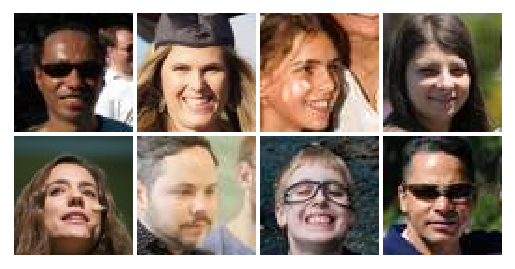

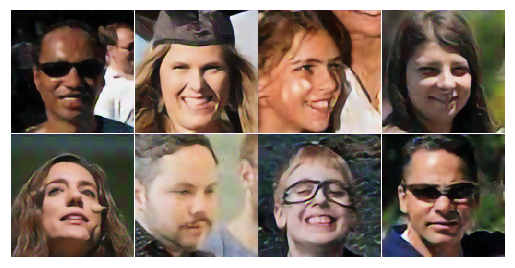

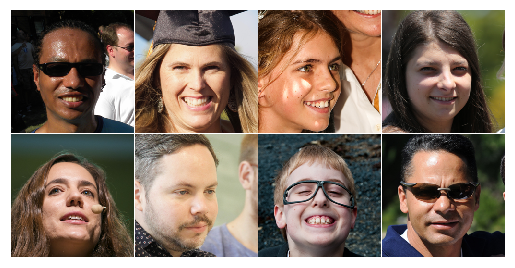

4 g 3.672393560409546 d 0.7864506244659424
8 g 3.701561450958252 d 1.1317776441574097
12 g 3.7699480056762695 d 1.1592650413513184
16 g 4.265820503234863 d 0.7487964034080505
20 g 3.4932191371917725 d 0.6164900064468384
24 g 3.4959752559661865 d 1.7208187580108643
28 g 3.8239495754241943 d 1.258165955543518
32 g 3.6253364086151123 d 0.7171580791473389
36 g 3.6668202877044678 d 1.454190969467163
40 g 3.630868911743164 d 1.8110747337341309
44 g 3.3311500549316406 d 1.4842442274093628
48 g 3.9156131744384766 d 0.554390549659729
52 g 3.3787317276000977 d 1.6879212856292725
56 g 3.9048197269439697 d 1.1158133745193481
60 g 3.8534677028656006 d 0.639347493648529


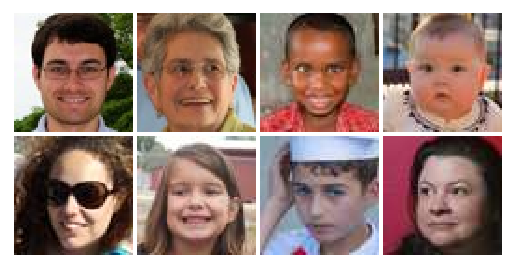

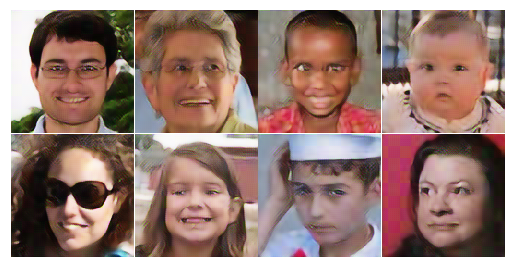

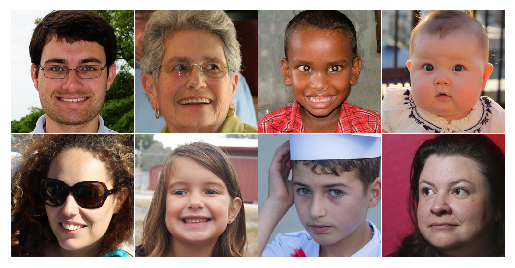

4 g 4.110346794128418 d 0.5327904224395752
8 g 3.6949243545532227 d 0.7543582916259766
12 g 4.277095317840576 d 1.037742018699646
16 g 3.699437141418457 d 1.0408005714416504
20 g 3.5446557998657227 d 1.232915997505188
24 g 3.7897000312805176 d 0.8298070430755615
28 g 3.413193702697754 d 1.1630014181137085
32 g 3.5417165756225586 d 1.6503069400787354
36 g 4.09015417098999 d 1.3478676080703735
40 g 3.754916191101074 d 0.7614543437957764
44 g 3.474491596221924 d 1.150604486465454
48 g 4.096415996551514 d 0.8639171123504639
52 g 3.3958687782287598 d 0.9334668517112732
56 g 3.5545008182525635 d 0.8329031467437744
60 g 3.8532540798187256 d 0.7072733640670776


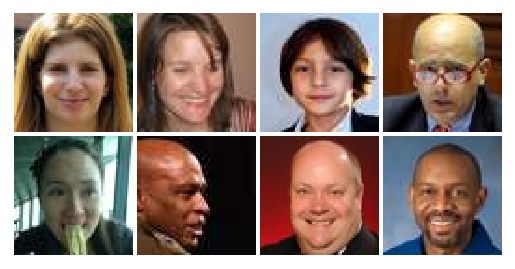

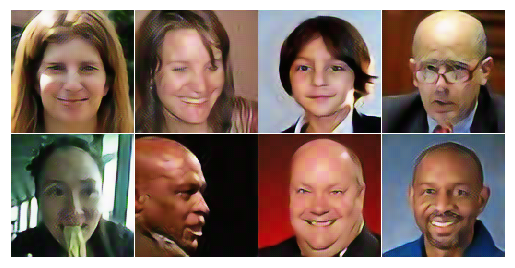

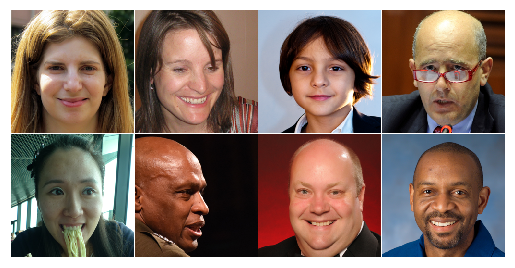

4 g 3.7865548133850098 d 1.2342103719711304
8 g 3.9018919467926025 d 0.6588230133056641
12 g 3.702303171157837 d 1.468349575996399
16 g 4.058444499969482 d 1.3747549057006836
20 g 3.4148011207580566 d 0.9212062954902649
24 g 3.5727009773254395 d 1.0028213262557983
28 g 3.950900077819824 d 0.4787375032901764
32 g 4.065274715423584 d 1.2406810522079468
36 g 3.96618390083313 d 0.838175892829895
40 g 3.7692558765411377 d 0.9138954877853394
44 g 3.267085075378418 d 1.4498471021652222
48 g 4.0698466300964355 d 0.8391094207763672
52 g 3.582169771194458 d 0.7543554902076721
56 g 3.692185163497925 d 2.3392677307128906
60 g 3.7141785621643066 d 1.1555931568145752


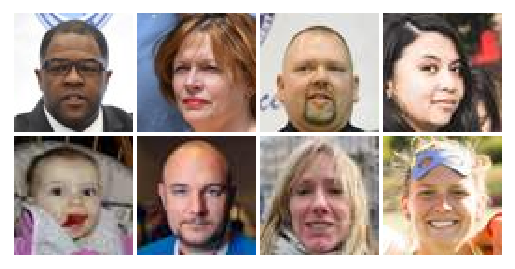

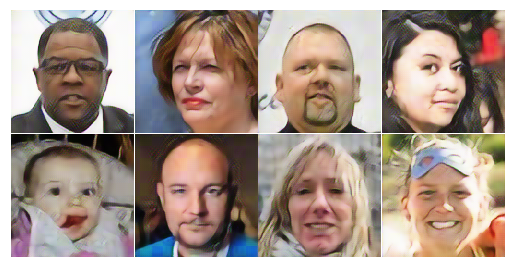

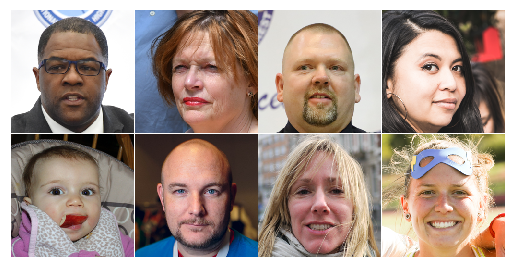

4 g 3.659435510635376 d 1.247359275817871
8 g 3.3982036113739014 d 0.7174826264381409
12 g 3.649137258529663 d 0.8429888486862183
16 g 4.1695637702941895 d 0.7689013481140137
20 g 4.171391487121582 d 0.9643632769584656
24 g 3.5284042358398438 d 1.0295568704605103
28 g 3.6692793369293213 d 1.1578229665756226
32 g 3.725849151611328 d 0.3957442045211792
36 g 3.5355052947998047 d 0.6135591268539429
40 g 3.8990983963012695 d 0.6964290142059326
44 g 3.9231436252593994 d 1.636756181716919
48 g 4.056801795959473 d 1.3357571363449097
52 g 3.62866473197937 d 0.9058142900466919
56 g 3.412558078765869 d 0.874900221824646
60 g 3.7226364612579346 d 1.2887635231018066


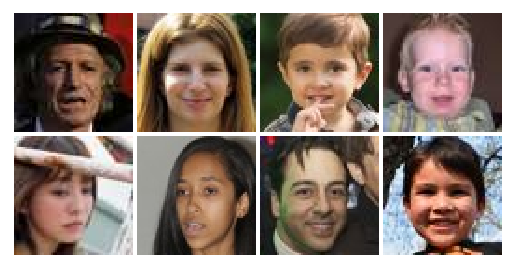

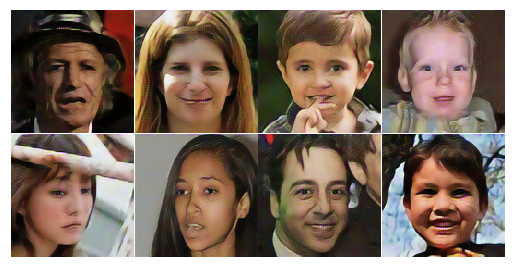

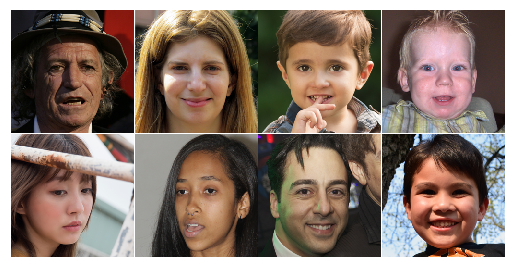

4 g 3.3897078037261963 d 0.9059280753135681
8 g 3.8916218280792236 d 1.5952708721160889
12 g 3.740793228149414 d 1.8956071138381958
16 g 3.269416093826294 d 0.6741365790367126
20 g 3.864893674850464 d 0.5620462894439697
24 g 3.651273488998413 d 0.9824904203414917
28 g 3.7536838054656982 d 0.7296719551086426
32 g 4.377347946166992 d 0.9372948408126831
36 g 3.7325825691223145 d 0.6438096165657043
40 g 3.5974133014678955 d 0.6767945885658264
44 g 3.859992027282715 d 0.7455435395240784
48 g 3.8379039764404297 d 1.1774569749832153
52 g 3.823333978652954 d 0.872778594493866
56 g 3.276911497116089 d 0.4209071695804596
60 g 3.709289312362671 d 0.8674769401550293


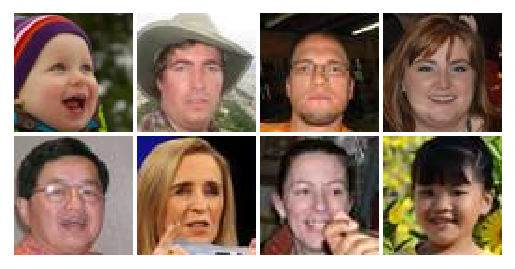

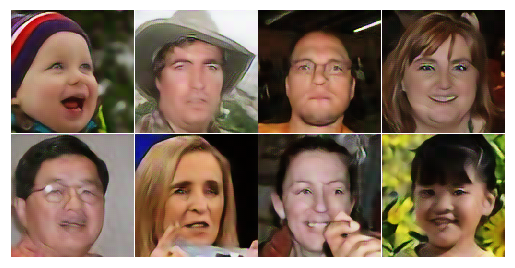

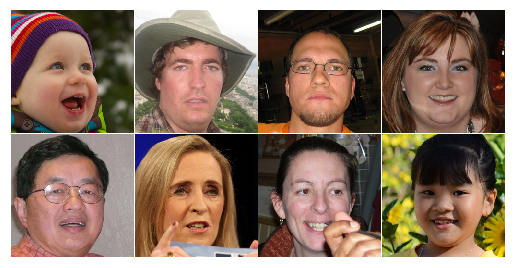

4 g 3.7840843200683594 d 0.5204375982284546
8 g 3.7613236904144287 d 1.3215503692626953
12 g 3.913365125656128 d 0.934127688407898
16 g 4.160957336425781 d 2.5422000885009766
20 g 3.6694793701171875 d 1.1253193616867065
24 g 3.3938801288604736 d 2.371939182281494
28 g 4.129096031188965 d 0.5298805236816406
32 g 3.7994375228881836 d 1.1386070251464844
36 g 3.497666835784912 d 1.0524070262908936
40 g 3.4421632289886475 d 1.0453343391418457
44 g 4.215621471405029 d 1.585363507270813
48 g 3.606452226638794 d 2.292604446411133
52 g 3.3619048595428467 d 1.7205737829208374
56 g 4.427367210388184 d 0.916465163230896
60 g 3.6289560794830322 d 0.7938878536224365


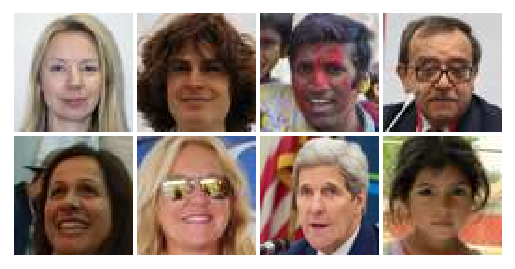

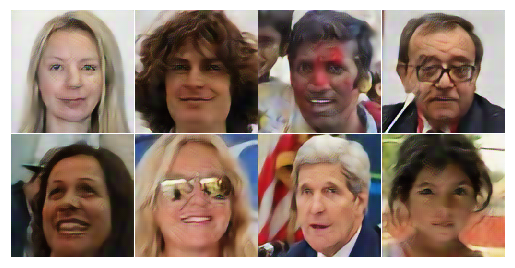

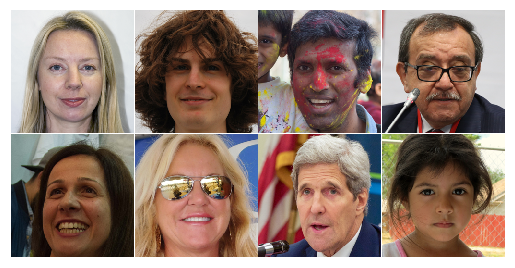

4 g 3.875882148742676 d 1.3015036582946777
8 g 4.566226005554199 d 0.455515056848526
12 g 3.8481528759002686 d 0.7060890197753906
16 g 3.6820356845855713 d 0.677238404750824
20 g 3.8007569313049316 d 0.7893999814987183
24 g 3.620997428894043 d 1.4858741760253906
28 g 4.4777374267578125 d 1.2390238046646118
32 g 4.009596347808838 d 0.42118439078330994
36 g 3.6070868968963623 d 1.0567781925201416
40 g 4.275251865386963 d 0.8752627968788147
44 g 4.041929721832275 d 1.271864891052246
48 g 3.6904051303863525 d 1.0524322986602783
52 g 3.4782848358154297 d 1.3248050212860107
56 g 4.145960807800293 d 1.0229506492614746
60 g 3.670544147491455 d 0.6717450022697449


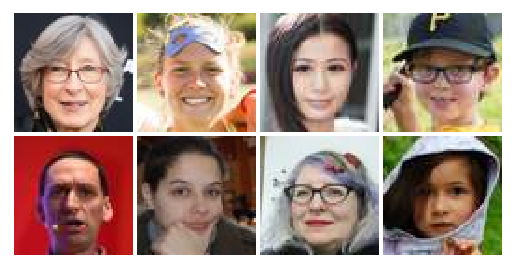

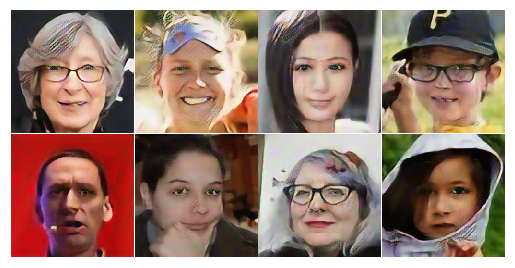

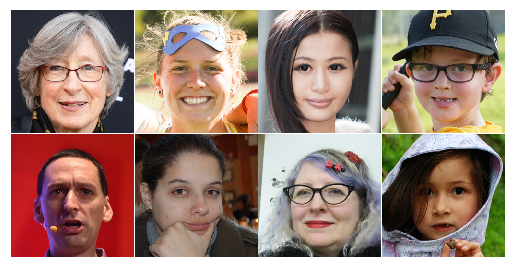

4 g 3.9842374324798584 d 0.8686646819114685
8 g 3.591400384902954 d 1.035438895225525
12 g 3.887930393218994 d 2.762923240661621
16 g 4.922241687774658 d 0.8062594532966614
20 g 3.8977787494659424 d 0.8973572850227356
24 g 3.5379512310028076 d 1.2205712795257568
28 g 3.830557346343994 d 1.6825894117355347
32 g 3.4499154090881348 d 1.172405481338501
36 g 3.9146621227264404 d 1.0303926467895508
40 g 3.5823700428009033 d 0.49831482768058777
44 g 4.119577884674072 d 1.0840153694152832
48 g 3.9904396533966064 d 0.6483216285705566
52 g 3.1755502223968506 d 1.0547784566879272
56 g 3.723564863204956 d 1.14751136302948
60 g 3.777675151824951 d 0.9862886071205139


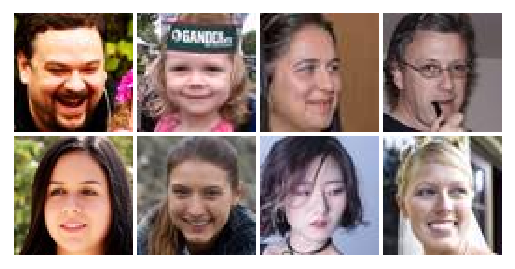

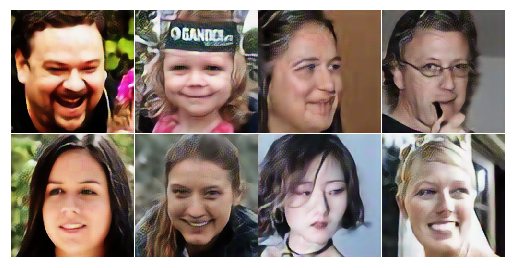

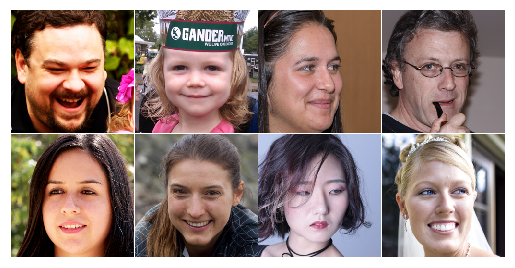

4 g 4.116218090057373 d 0.8116840124130249
8 g 3.567952871322632 d 1.1230944395065308
12 g 3.7549874782562256 d 0.912024974822998
16 g 3.3920884132385254 d 1.0607943534851074
20 g 3.8468053340911865 d 0.5879038572311401
24 g 3.834244728088379 d 1.27256441116333
28 g 3.6829001903533936 d 0.9800074100494385
32 g 4.426336288452148 d 0.5119102597236633
36 g 4.044728755950928 d 1.1237848997116089
40 g 3.891723394393921 d 0.7694743871688843
44 g 4.0485429763793945 d 1.0112996101379395
48 g 4.092489242553711 d 1.0867173671722412
52 g 4.0751471519470215 d 1.664565086364746
56 g 3.8049912452697754 d 1.4994500875473022
60 g 3.4562442302703857 d 1.2369040250778198
Epoch 00018: reducing learning rate of group 0 to 1.0000e-04.


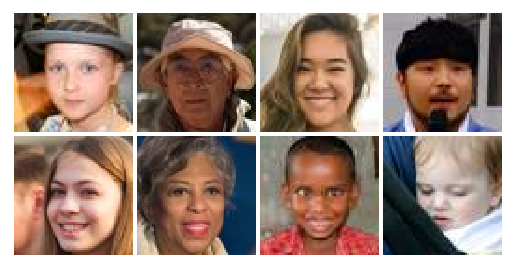

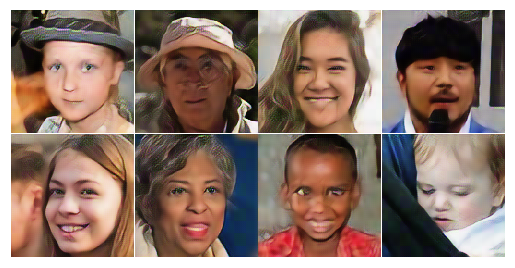

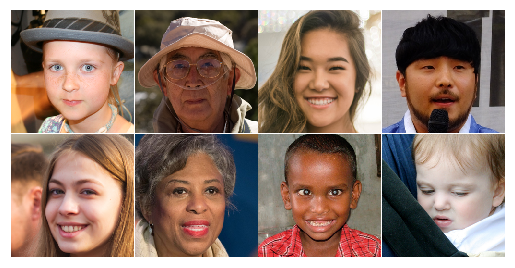

4 g 3.945270538330078 d 0.6517337560653687
8 g 3.7381491661071777 d 0.45751434564590454
12 g 3.9442102909088135 d 1.1204034090042114
16 g 3.522928237915039 d 0.4601176977157593
20 g 4.097745895385742 d 0.48646777868270874
24 g 4.183250904083252 d 0.9174675941467285
28 g 3.9363901615142822 d 1.0444536209106445
32 g 3.754136800765991 d 1.3195301294326782
36 g 4.42647123336792 d 0.5771470665931702
40 g 3.3628220558166504 d 0.5022302269935608
44 g 4.34354305267334 d 0.2702895402908325
48 g 3.848827838897705 d 0.28379151225090027
52 g 3.553800106048584 d 0.29058194160461426
56 g 3.410552740097046 d 0.460446298122406
60 g 3.824045419692993 d 0.5886058807373047


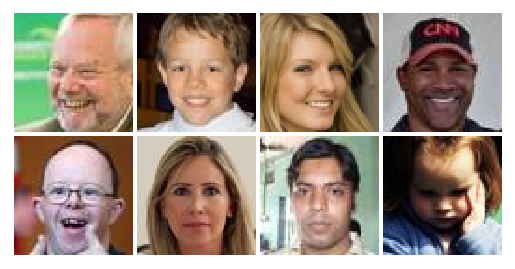

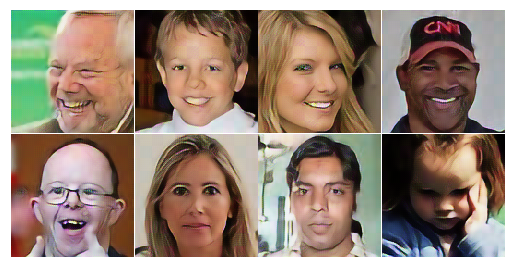

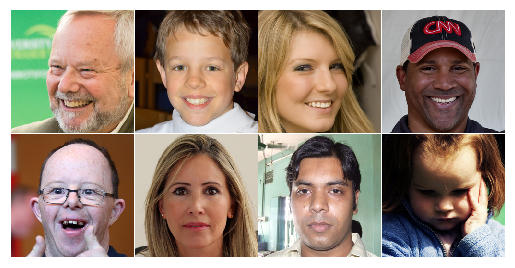

4 g 3.758659839630127 d 1.1366297006607056
8 g 3.9570248126983643 d 1.4541542530059814
12 g 4.093705654144287 d 1.6401704549789429
16 g 3.8529608249664307 d 0.7164416313171387
20 g 4.335675239562988 d 0.4764605462551117
24 g 3.882901191711426 d 0.2632569670677185
28 g 3.685326337814331 d 0.3223766088485718
32 g 3.7466869354248047 d 0.4467736482620239
36 g 3.8359649181365967 d 0.5447710752487183
40 g 4.158348560333252 d 0.7673611640930176
44 g 3.559591293334961 d 1.3861443996429443
48 g 4.342912197113037 d 0.8436934947967529
52 g 3.8396334648132324 d 0.7072526812553406
56 g 3.619931697845459 d 0.5126460790634155
60 g 3.9286136627197266 d 0.30729398131370544


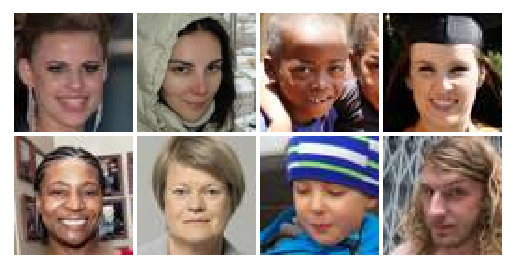

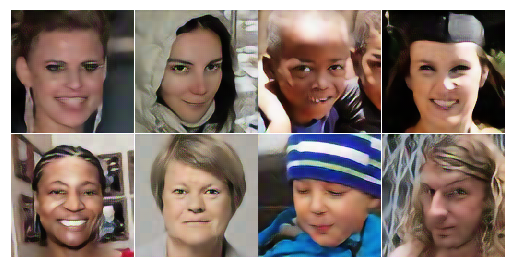

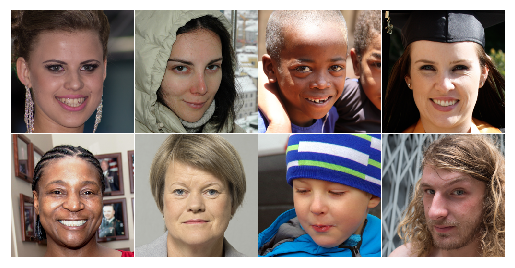

4 g 3.6136562824249268 d 0.413196325302124
8 g 3.4909591674804688 d 0.605295717716217
12 g 4.940627098083496 d 0.631625771522522
16 g 3.643394947052002 d 0.5266172885894775
20 g 3.9912662506103516 d 0.47298377752304077
24 g 4.362499237060547 d 1.1647398471832275
28 g 3.6202547550201416 d 0.8980505466461182
32 g 3.8666951656341553 d 0.4483978748321533
36 g 3.5133473873138428 d 0.34633761644363403
40 g 4.191187858581543 d 0.36979585886001587
44 g 3.593813419342041 d 0.47479337453842163
48 g 3.9018726348876953 d 1.0668938159942627
52 g 4.188009262084961 d 1.152937889099121
56 g 4.2711710929870605 d 0.7654971480369568
60 g 4.480030536651611 d 0.5458938479423523


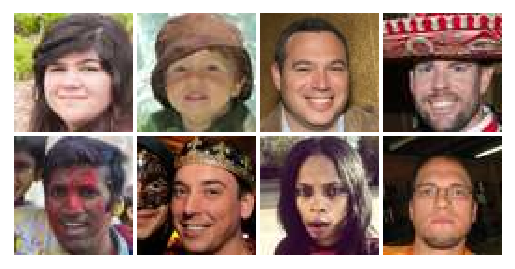

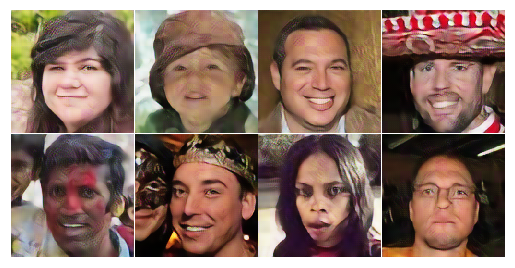

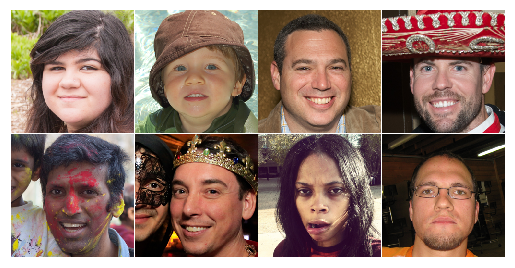

4 g 3.7356204986572266 d 0.2501046657562256
8 g 3.770575761795044 d 0.2292788177728653
12 g 3.8841753005981445 d 0.19022494554519653
16 g 3.841177225112915 d 0.5350479483604431
20 g 3.8649630546569824 d 0.9867236018180847
24 g 4.318756580352783 d 0.296196848154068
28 g 3.8269202709198 d 0.3927355706691742
32 g 4.537569522857666 d 0.4778955280780792
36 g 4.345647811889648 d 0.2407197654247284
40 g 4.154709815979004 d 0.28414851427078247
44 g 3.5294063091278076 d 0.4292871952056885
48 g 4.376033306121826 d 0.6067266464233398
52 g 3.948132276535034 d 1.3177604675292969
56 g 4.224325180053711 d 0.9251572489738464
60 g 3.524780511856079 d 1.0430350303649902


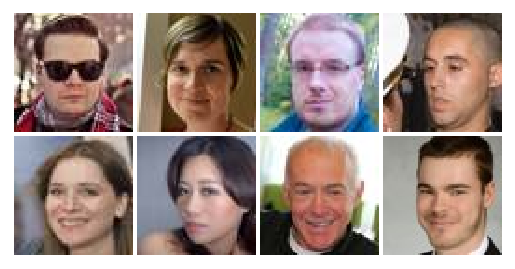

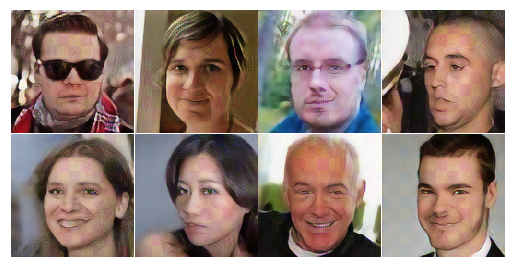

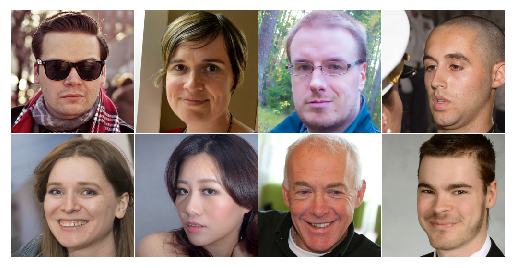

4 g 4.041374683380127 d 0.7030003666877747
8 g 3.7622530460357666 d 0.18242263793945312
12 g 3.8671786785125732 d 0.2936284840106964
16 g 4.344770431518555 d 0.31046709418296814
20 g 4.266422271728516 d 0.606134295463562
24 g 4.33505916595459 d 1.1822621822357178
28 g 3.813263416290283 d 0.7011632323265076
32 g 4.754533290863037 d 0.27179276943206787
36 g 4.445424556732178 d 0.6626437306404114
40 g 3.73433518409729 d 0.47123271226882935
44 g 3.5557868480682373 d 0.5584272146224976
48 g 3.6865925788879395 d 0.5033215880393982
52 g 4.114068508148193 d 0.2555083632469177
56 g 4.073400020599365 d 0.5491842031478882
60 g 4.575101375579834 d 1.3422906398773193


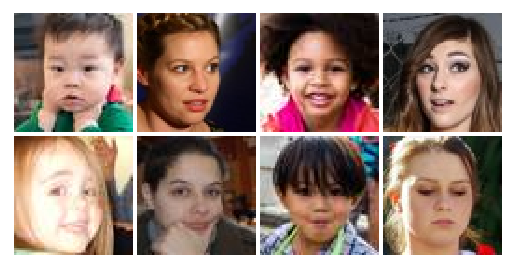

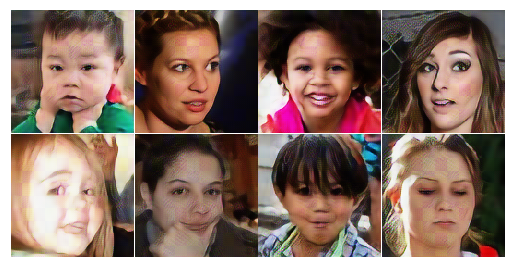

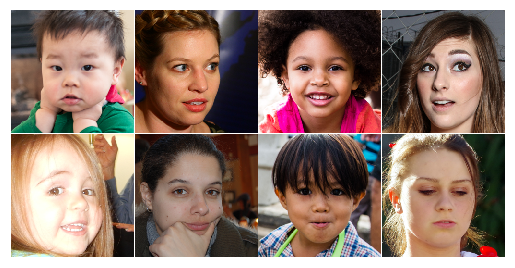

4 g 4.038723945617676 d 0.8007898330688477
8 g 3.8953933715820312 d 0.44333308935165405
12 g 4.178544044494629 d 0.4542374014854431
16 g 4.048598289489746 d 0.345812052488327
20 g 3.9766745567321777 d 0.4872116446495056
24 g 4.16939640045166 d 0.5852593779563904
28 g 3.945420265197754 d 0.35839080810546875
32 g 4.495600700378418 d 0.9100944995880127
36 g 3.7347705364227295 d 0.5331238508224487
40 g 4.18830680847168 d 0.1325027346611023
44 g 4.309438228607178 d 0.16961528360843658
48 g 4.01964807510376 d 0.219121515750885
52 g 3.866901159286499 d 0.13726797699928284
56 g 4.8526201248168945 d 0.3625794053077698
60 g 3.6463186740875244 d 1.5161505937576294


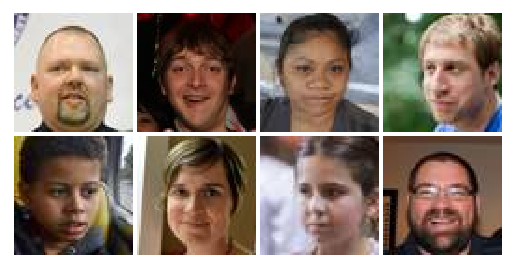

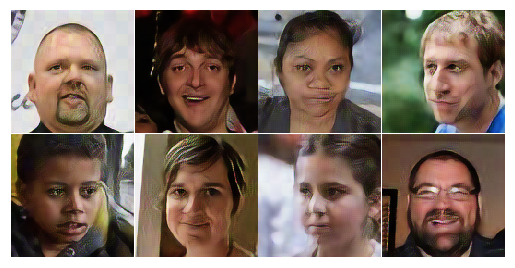

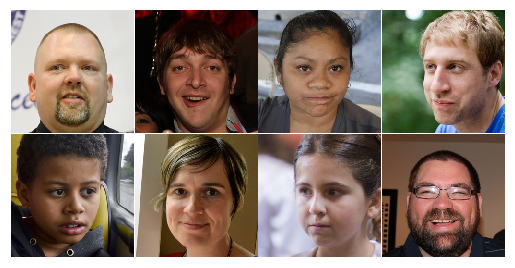

4 g 4.887064456939697 d 0.4862697720527649
8 g 3.856816053390503 d 1.2775170803070068
12 g 3.9193222522735596 d 1.1027021408081055
16 g 3.98599910736084 d 0.3309611976146698
20 g 4.114946365356445 d 0.2316809743642807
24 g 3.9696850776672363 d 0.177888423204422
28 g 3.938356876373291 d 0.14196603000164032
32 g 4.3095855712890625 d 0.22894012928009033
36 g 3.901475429534912 d 0.1427343785762787
40 g 4.182207107543945 d 0.189336895942688
44 g 3.698784351348877 d 0.573871374130249
48 g 4.407610893249512 d 0.33751165866851807
52 g 3.9144768714904785 d 0.4466933012008667
56 g 4.372274875640869 d 0.607327938079834
60 g 3.889456033706665 d 0.2743804156780243


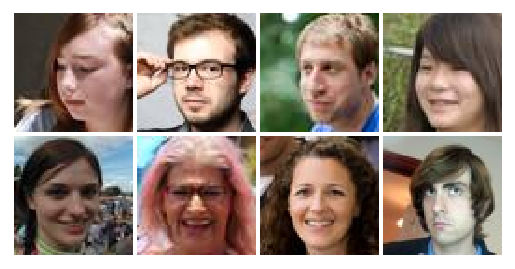

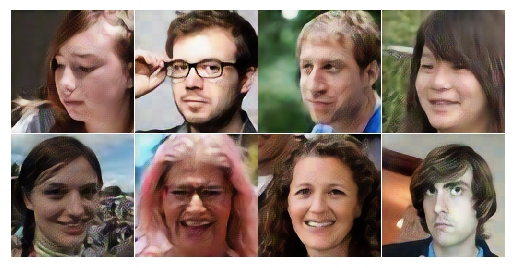

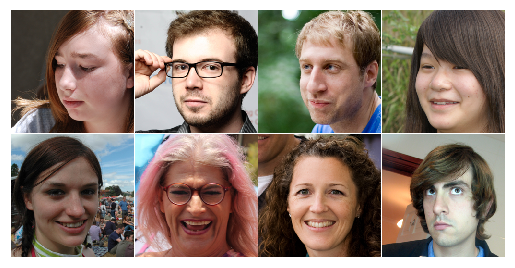

4 g 3.7505874633789062 d 0.3951932489871979
8 g 4.149759292602539 d 0.5688828825950623
12 g 3.4840056896209717 d 0.6072156429290771
16 g 4.0162458419799805 d 0.5437967777252197
20 g 4.166622161865234 d 0.21524670720100403
24 g 3.9809060096740723 d 0.3858545422554016
28 g 4.193245887756348 d 0.5578173995018005
32 g 4.14060640335083 d 0.3729099929332733
36 g 4.226006984710693 d 0.3813501000404358
40 g 4.316076755523682 d 0.17603304982185364
44 g 3.9592559337615967 d 0.2558909058570862
48 g 3.8019614219665527 d 1.0529645681381226
52 g 4.27016544342041 d 1.0259060859680176
56 g 4.429790496826172 d 0.3422342836856842
60 g 4.049785614013672 d 0.5012058019638062


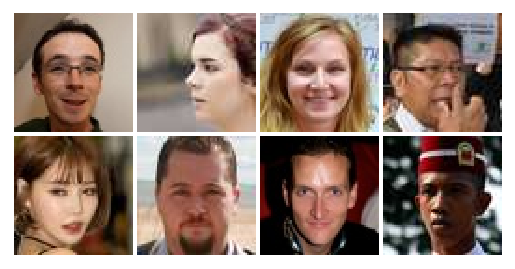

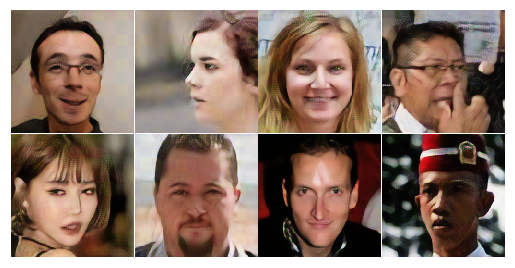

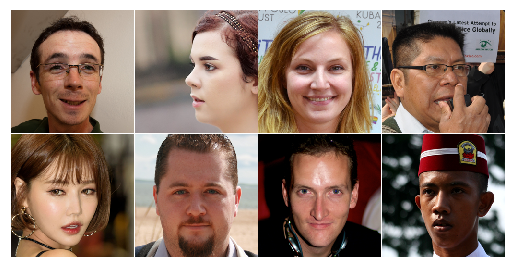

4 g 3.7817816734313965 d 0.24446244537830353
8 g 3.6770644187927246 d 0.5730890035629272
12 g 4.298622131347656 d 0.5297514200210571
16 g 4.328346252441406 d 0.6456403136253357
20 g 4.13749885559082 d 0.3229183554649353
24 g 3.8606655597686768 d 0.2298070192337036


In [10]:
batch_size = 16

for epoch in range(10000):
    trainloader = torch.utils.data.DataLoader(
        RawDataset(2**17), batch_size=batch_size, shuffle=True)
    
    total_loss = None
    batch_count = 0

    for x, y in trainloader:
        x = x.to(device)
        y = y.to(device)

        real_labels = torch.ones(x.shape[0], 1).to(device)
        fake_labels = torch.zeros(x.shape[0], 1).to(device)

        # Update Discriminator
        optimizer_d.zero_grad()
        real_outputs = discriminator(y)
        d_loss_real = lossfun(None, real_labels, real_outputs, is_discriminator=True)

        fake_images = model(x)
        fake_outputs = discriminator(fake_images.detach())
        d_loss_fake = lossfun(None, fake_labels, fake_outputs, is_discriminator=True)

        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        regl2 = 1.0 * torch.mean((discriminator_params)**2)
        regl2.backward()
        optimizer_d.step()

        # Update Generator
        optimizer.zero_grad()
        fake_outputs = discriminator(fake_images)
        g_loss = lossfun(fake_images, y, fake_outputs)
        g_loss.backward()
        optimizer.step()

        if total_loss is None:
            total_loss = g_loss
        else:
            total_loss += g_loss
        batch_count += 1

        if batch_count % 4 == 0:
            print(batch_count, 'g', g_loss.item(), 'd', d_loss.item())

    model_g_path = "model01_x4.pth"
    model_d_path = "model01_d.pth"
    torch.save(model, model_g_path)
    torch.save(discriminator, model_d_path)

    mean_loss = total_loss / batch_count
    scheduler.step(mean_loss)
    if optimizer.param_groups[0]['lr'] < 1e-5:
        break

    if epoch % 1 == 0:
        plot_imgs(x)
        plot_imgs(fake_images.detach())
        plot_imgs(y)
